# Generating Word Embedding Models using Gensim, Exploratory Data Analysis Notebook

In [1]:
sys.path.append(r"C:\Users\robal\Dropbox\UChicago\Year II\Quarter III\Advanced Machine Learning\Project\GenderProject")

In [3]:
import pandas as pd 
import numpy as np 
import gensim 
import gensim.downloader as api
import spacy 
from pre_process.text_utils import *
from word_embedding.word_to_vec import *

nlp_spanish = spacy.load("es_core_news_sm")

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Mexican Newspaper Analysis

## Load all three corpus.

In [13]:
jornada_df = pd.read_excel("../data/Mexico/la_jornada_scraped.xlsx")
universal_df = pd.read_excel("../data/Mexico/el_universal_scraped.xlsx")
el_heraldo_df = pd.read_excel("../data/Mexico/Heraldo_scraped.xlsx")

In [14]:
print(f"""
          There are {jornada_df.shape[0]} articles from la Jornada.
          There are {universal_df.shape[0]} articles from el Universal.
          There are {el_heraldo_df.shape[0]} articles from el Heraldo.""")


          There are 2099 articles from la Jornada.
          There are 3513 articles from el Universal.
          There are 2820 articles from el Heraldo.


In [15]:
# Join both text columns
jornada_df["title"] = jornada_df["title"].str.pad(1, side ='right', fillchar =' ')
jornada_df["complete_text"]  = jornada_df.title.str.cat(jornada_df.text).astype(str)

universal_df["complete_text"]  = universal_df.title.str.cat(universal_df.text).astype(str)
el_heraldo_df["complete_text"]  = el_heraldo_df.title.str.cat(el_heraldo_df.text).astype(str)

## Create word2vec objects for each newspaper

In [18]:
cbow_Embed = WEmbeddings(jornada_df, "complete_text")
laJornada_w2v = cbow_Embed()

In [21]:
cbow_Embed = WEmbeddings(universal_df, "complete_text")
elUniversal_w2v = cbow_Embed()

In [22]:
cbow_Embed = WEmbeddings(el_heraldo_df, "complete_text")
elHeraldo_w2v = cbow_Embed()

In [4]:
# If already saved just load the embeddings since creating them is computationally expensive
laJornada_w2v = gensim.models.Word2Vec.load("../data/Mexico/laJornada_w2v.model")
elUniversal_w2v = gensim.models.Word2Vec.load("../data/Mexico/elUniversal_w2v.model")
elHeraldo_w2v = gensim.models.Word2Vec.load("../data/Mexico/elHeraldo_w2v.model")

w2v_dict = {"La Jornada": laJornada_w2v, "El Universal":elUniversal_w2v, "El Heraldo": elHeraldo_w2v}

In [62]:
words_of_interest = ["hombre", "mujer" , "abuso", "lugar", "victima", "culpa", "responsabilidad"]
results = []

for word in words_of_interest:
    print(f"Finding words most similar to '{word}' according to its embedding")

    rep_words_jor, sentiment_jor = extract_info_word2vec(laJornada_w2v, word, 'es')
    rep_words_uni, sentiment_uni = extract_info_word2vec(elUniversal_w2v, word, 'es')
    rep_words_heral, sentiment_heral = extract_info_word2vec(elHeraldo_w2v, word, 'es')


    d = { "keyword": word, 
          "closest_jor": rep_words_jor,
          "sentiment_jor": sentiment_jor,
          "closest_uni": rep_words_uni,
          "sentiment_uni": sentiment_uni,
          "closest_heral": rep_words_heral,
          "sentiment_heral": sentiment_heral
            }
    results.append(d)


results_df = pd.DataFrame(results)

Finding words most similar to 'hombre' according to its embedding
Finding words most similar to 'mujer' according to its embedding
Finding words most similar to 'abuso' according to its embedding
Finding words most similar to 'lugar' according to its embedding
Finding words most similar to 'victima' according to its embedding
Finding words most similar to 'culpa' according to its embedding
Finding words most similar to 'responsabilidad' according to its embedding


In [93]:
results_df

,keyword,closest_jor,sentiment_jor,closest_uni,sentiment_uni,closest_heral,sentiment_heral
0,hombre,"[murió, desaparecida, detenido, joven, sujeto,...",-0.068,"[identifica, merecía, indignante, marido, habl...",-0.829,"[niño, bebé, sujeto, tenía, murió, sexualmente...",-0.904
1,mujer,"[niña, menor, víctima, joven, muerte, consenti...",0.101,"[violente, autosuficiencia, clasificado, vez, ...",-0.586,"[muerte, privó, embarazada, niña, acera, menor...",-0.067
2,abuso,"[agresión, sexual, acoso, penetración, inaprop...",-0.936,"[sexual, acoso, agresión, acusado, violación, ...",-0.039,"[agresión, depredador, acoso, inapropiada, exp...",-0.004
3,lugar,"[mes, sismo, año, periodo, febrero, transporta...",-0.752,"[público, lanzamiento, proceso, cantó, movimie...",0.354,"[interior, transcurso, vehículo, ocurrieron, s...",-0.283
4,victima,NaN,NaN,NaN,NaN,"[nacionalidad, tragedia, cruel, restricción, l...",-0.004
5,culpa,"[cosa, opción, fuerte, supervivencia, cierto, ...",-0.987,"[hago, pregunta, sorpresa, corazón, jamás, irm...",0.017,"[triste, mía, siento, incómoda, feliz, sentir,...",-1.000
6,responsabilidad,"[posible, autoridad, causa, debido, participac...",0.278,"[existencia, labor, institución, respuesta, pr...",-0.806,"[legislación, obligación, agravios, acción, ac...",-0.775


In [98]:
results_df.to_excel("Mexico_word2vec_summary.xlsx")

### Word analogies and semantic algebra

In [19]:
for w2v in w2v_dict.keys():
    print("Newspaper: ", w2v)
    print(analogy_solving(w2v_dict[w2v], ["mujer", "afectada"], ["hombre"]))

    print()

Newspaper:  La Jornada
[('expresión', 0.9108599424362183), ('condición', 0.904948353767395), ('completa', 0.8901214599609375), ('ideología', 0.8890320062637329), ('conlleva', 0.8882717490196228), ('sanción', 0.8868190050125122), ('maternidad', 0.8829052448272705), ('igualitaria', 0.882896900177002), ('sexualidad', 0.8827148675918579), ('eliminación', 0.8825799822807312)]

Newspaper:  El Universal
[('libre', 0.9254752397537231), ('política', 0.9226861596107483), ('modalidad', 0.9218763709068298), ('manpowergroup', 0.9215972423553467), ('nom', 0.920766294002533), ('crueldad', 0.9203529357910156), ('erradicar', 0.9202438592910767), ('estrategia', 0.9159619808197021), ('educación', 0.9148995876312256), ('paridad', 0.9144420623779297)]

Newspaper:  El Heraldo
[('definición', 0.8249168992042542), ('subordinación', 0.8193236589431763), ('vacuna', 0.8183871507644653), ('reflexión', 0.8151737451553345), ('pare', 0.8144881725311279), ('violenta', 0.813068151473999), ('mujerla', 0.812536716461181

### Visualizing Word Embeddings using dimensionality reduction

In [32]:
# Retrieve vectors
X_jornada = laJornada_w2v[laJornada_w2v.wv.vocab]
X_universal = elUniversal_w2v[elUniversal_w2v.wv.vocab]
X_heraldo = elHeraldo_w2v[elHeraldo_w2v.wv.vocab]

<ipython-input-32-c4ea8209679c>:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_jornada = laJornada_w2v[laJornada_w2v.wv.vocab]
<ipython-input-32-c4ea8209679c>:3: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_universal = elUniversal_w2v[elUniversal_w2v.wv.vocab]
<ipython-input-32-c4ea8209679c>:4: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_heraldo = elHeraldo_w2v[elHeraldo_w2v.wv.vocab]


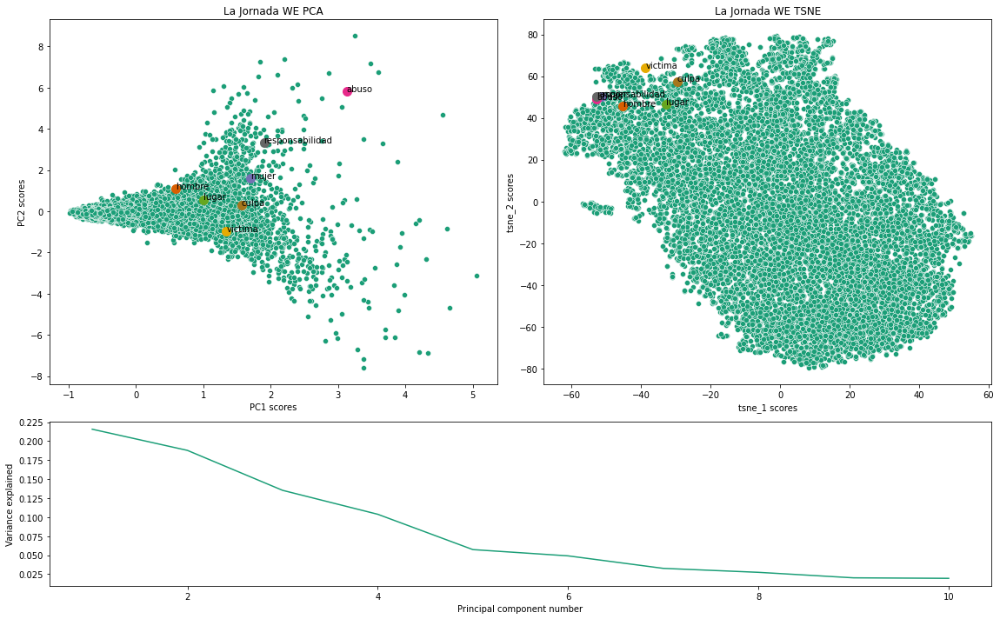

In [37]:
fig = visualize_embeddings(X_jornada, words_of_interest, "La Jornada WE")

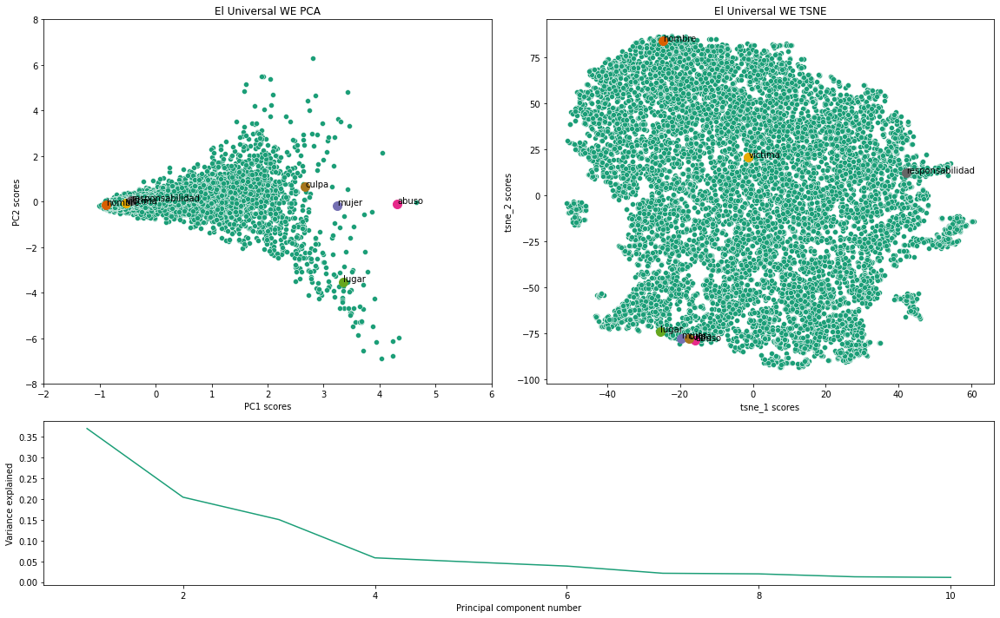

In [38]:
fig = visualize_embeddings(X_universal, words_of_interest, "El Universal WE", [-2, 6], [-8, 8]) 

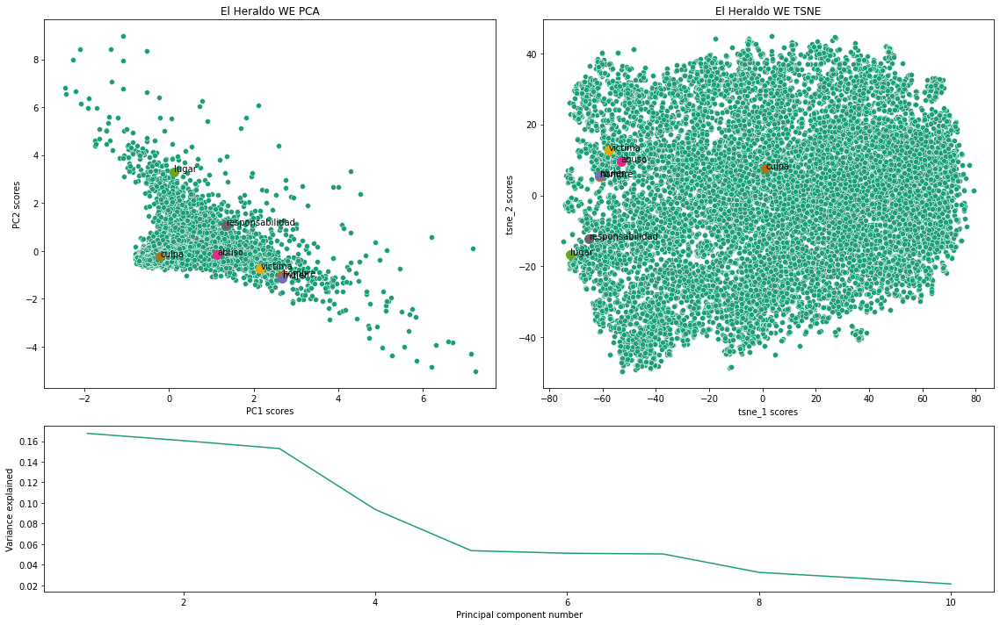

In [39]:
fig = visualize_embeddings(X_heraldo, words_of_interest, "El Heraldo WE")

### Save models for later use

In [37]:
# laJornada_w2v.save("../data/Mexico/laJornada_w2v.model")
# elUniversal_w2v.save("../data/Mexico/elUniversal_w2v.model")
# elHeraldo_w2v.save("../data/Mexico/elUniversal_w2v.model")

# Pakistan Newspaper Analysis

In [42]:
df3 = pd.read_csv("../data/Pakistan/pak_extracted_combined_2020.csv")
df3 = df3[['link', 'datetime', 'title', 'text', 'authors', 'summary', 'keywords']]
df3 = df3[['link', 'datetime', 'title', 'text', 'authors', 'summary', 'keywords']]

df3['newspaper'] = ""
df3['newspaper'] = np.where(df3.link.str.contains("nation.com"), "nation", df3.newspaper)
df3['newspaper'] = np.where(df3.link.str.contains("news.com"), "news", df3.newspaper)
df3['newspaper'] = np.where(df3.link.str.contains("dawn.com"), "dawn", df3.newspaper)

nation_df = df3[df3['newspaper']=='nation']
dawn_df = df3[df3['newspaper']=='dawn']
thenews_df = df3[df3['newspaper']=='news']

In [43]:
thenews_df.loc[:,"title"] = thenews_df["title"].str.pad(1, side ='right', fillchar =' ')
thenews_df.loc[:,"complete_text"]  = thenews_df.title.str.cat(thenews_df.text).astype(str)

dawn_df.loc[:,"title"] = dawn_df["title"].str.pad(1, side ='right', fillchar =' ')
dawn_df.loc[:,"complete_text"]  = dawn_df.title.str.cat(dawn_df.text).astype(str)

nation_df.loc[:,"title"] = nation_df["title"].str.pad(1, side ='right', fillchar =' ')
nation_df.loc[:,"complete_text"]  = nation_df.title.str.cat(dawn_df.text).astype(str)

C:\Users\robal\miniconda3\envs\nlp_class\lib\site-packages\pandas\core\indexing.py:1842: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item_labels[indexer[info_axis]]] = value
C:\Users\robal\miniconda3\envs\nlp_class\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value
C:\Users\robal\miniconda3\envs\nlp_class\lib\site-packages\pandas\core\indexing.py:1675: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

### Create word2vec objects for each newspaper


In [44]:
cbow_Embed = WEmbeddings(thenews_df, "complete_text")
theNews_w2v = cbow_Embed()

C:\Users\robal\Dropbox\UChicago\Year II\Quarter III\Advanced Machine Learning\Project\GenderProject\word_embedding\word_to_vec.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.main_df[self.docs_index] = self.main_df[self.docs_index].apply(lambda row: clean_raw_text([row])[0])
C:\Users\robal\Dropbox\UChicago\Year II\Quarter III\Advanced Machine Learning\Project\GenderProject\word_embedding\word_to_vec.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.main_df['tokenized_sentences'] = self.mai

In [48]:
cbow_Embed = WEmbeddings(dawn_df, "complete_text")
Dawn_w2v = cbow_Embed()

C:\Users\robal\Dropbox\UChicago\Year II\Quarter III\Advanced Machine Learning\Project\GenderProject\word_embedding\word_to_vec.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.main_df[self.docs_index] = self.main_df[self.docs_index].apply(lambda row: clean_raw_text([row])[0])
C:\Users\robal\Dropbox\UChicago\Year II\Quarter III\Advanced Machine Learning\Project\GenderProject\word_embedding\word_to_vec.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.main_df['tokenized_sentences'] = self.mai

In [49]:
cbow_Embed = WEmbeddings(nation_df, "complete_text")
Nation_w2v = cbow_Embed()

In [66]:
words_of_interest = ["man", "woman", "abuse", "place", "victim", "blame", "responsibility"]
results = []

for word in words_of_interest:
    print(f"Finding words most similar to '{word}' according to its embedding")

    rep_words_jor, sentiment_jor = extract_info_word2vec(theNews_w2v, word, 'en')
    rep_words_uni, sentiment_uni = extract_info_word2vec(Dawn_w2v, word, 'en')
    rep_words_heral, sentiment_heral = extract_info_word2vec(Nation_w2v, word, 'en')


    d = { "keyword": word, 
          "closest_the_news": rep_words_jor,
          "sentiment_the_news": sentiment_jor,
          "closest_dawn": rep_words_uni,
          "sentiment_dawn": sentiment_uni,
          "closest_nation": rep_words_heral,
          "sentiment_nation": sentiment_heral
            }
    results.append(d)

Finding words most similar to 'man' according to its embedding
Finding words most similar to 'woman' according to its embedding
Finding words most similar to 'abuse' according to its embedding
Finding words most similar to 'place' according to its embedding
Finding words most similar to 'victim' according to its embedding
Finding words most similar to 'blame' according to its embedding
Finding words most similar to 'responsibility' according to its embedding


In [67]:
resulds_df_pak = pd.DataFrame(results)
resulds_df_pak

,keyword,closest_the_news,sentiment_the_news,closest_dawn,sentiment_dawn,closest_nation,sentiment_nation
0,man,"[minor, murder, kidnap, girl, mother, teenage,...",-0.9571,"[woman, justice, say, work, police, take, case...",0.5267,NaN,NaN
1,woman,"[child, domestic, subject, sexual, harassment,...",-0.8020,"[say, violence, ali, police, justice, law, sta...",-0.1779,NaN,NaN
2,abuse,"[sexual, child, woman, domestic, year, assault...",-0.8074,"[child, sexual, say, state, case, country, pol...",0.0000,NaN,NaN
3,place,"[hour, suggest, week, carry, follow, learn, aw...",0.5975,"[justice, law, say, government, take, country,...",0.5267,NaN,NaN
4,victim,"[file, involve, accord, night, claim, tuesday,...",0.0000,"[police, say, law, state, report, woman, peopl...",0.5267,NaN,NaN
5,blame,"[follow, authority, anti, bring, culture, shar...",-0.0057,"[adviser, anti, hour, behaviour, keep, drug, b...",-0.3182,NaN,NaN
6,responsibility,"[give, offer, home, president, director, senat...",0.0000,"[complainant, court, woman, minister, allege, ...",-0.1779,NaN,NaN


In [100]:
resulds_df_pak.to_excel("Pakistan_word2vec_summary.xlsx")

In [21]:
# Load if already trained
theNews_w2v = gensim.models.Word2Vec.load("../data/Pakistan/theNews_w2v.model")
Dawn_w2v = gensim.models.Word2Vec.load("../data/Pakistan/Dawn_w2v.model")
Nation_w2v = gensim.models.Word2Vec.load("../data/Pakistan/Nation_w2v.model")

w2v_dict = {"The News": theNews_w2v, "Dawn":Dawn_w2v, "Nation": Nation_w2v}

## Word Analogies and Semantic Algebra

In [24]:
for w2v in w2v_dict.keys():
    print("Newspaper: ", w2v)
    print(analogy_solving(w2v_dict[w2v], ["woman", "victim"], ["man"]))

    print()

Newspaper:  The News
[('domestic', 0.9993048906326294), ('harassment', 0.9992272853851318), ('country', 0.9992173910140991), ('increase', 0.9991278648376465), ('rise', 0.9990671873092651), ('pakistan', 0.999056875705719), ('experience', 0.9989741444587708), ('rate', 0.9989572763442993), ('end', 0.9989429116249084), ('prevent', 0.9989269971847534)]

Newspaper:  Dawn
[('report', 0.999901294708252), ('police', 0.9998966455459595), ('law', 0.9998956918716431), ('state', 0.9998952150344849), ('society', 0.9998923540115356), ('say', 0.9998915195465088), ('karachi', 0.99988853931427), ('violence', 0.9998884797096252), ('need', 0.9998880624771118), ('sindh', 0.9998879432678223)]

Newspaper:  Nation


KeyError: "word 'woman' not in vocabulary"

### Visualizing Word Embeddings using dimensionality reduction

In [68]:
# Retrieve vectors
X_the_news = theNews_w2v[theNews_w2v.wv.vocab]
X_dawn = Dawn_w2v[Dawn_w2v.wv.vocab]
X_nation = Nation_w2v[Nation_w2v.wv.vocab]

<ipython-input-68-dbffa511ee42>:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_the_news = theNews_w2v[theNews_w2v.wv.vocab]
<ipython-input-68-dbffa511ee42>:3: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_dawn = Dawn_w2v[Dawn_w2v.wv.vocab]
<ipython-input-68-dbffa511ee42>:4: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_nation = Nation_w2v[Nation_w2v.wv.vocab]


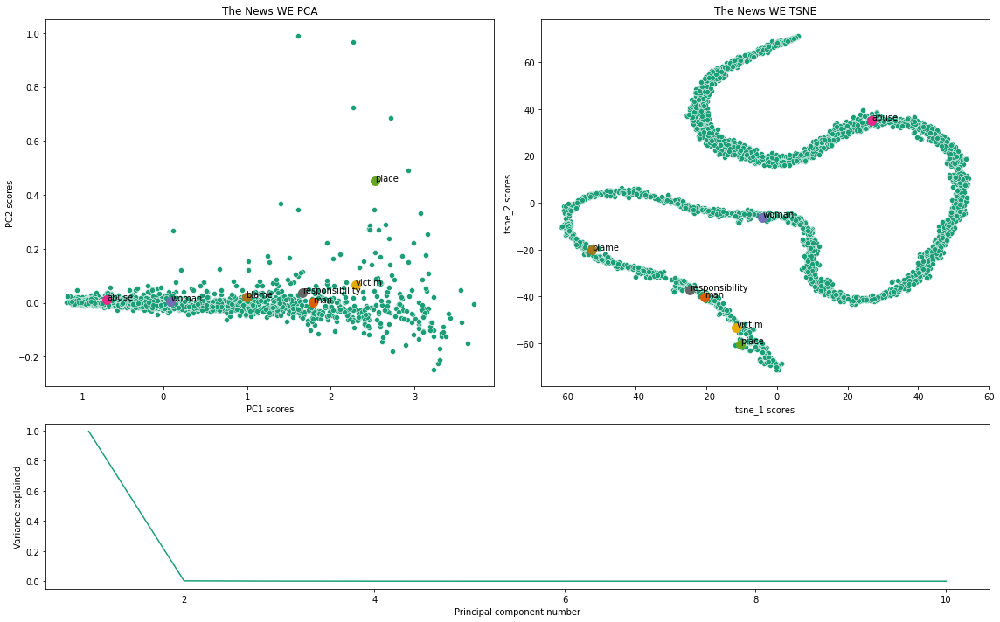

In [69]:
fig = visualize_embeddings(X_the_news, words_of_interest, "The News WE")

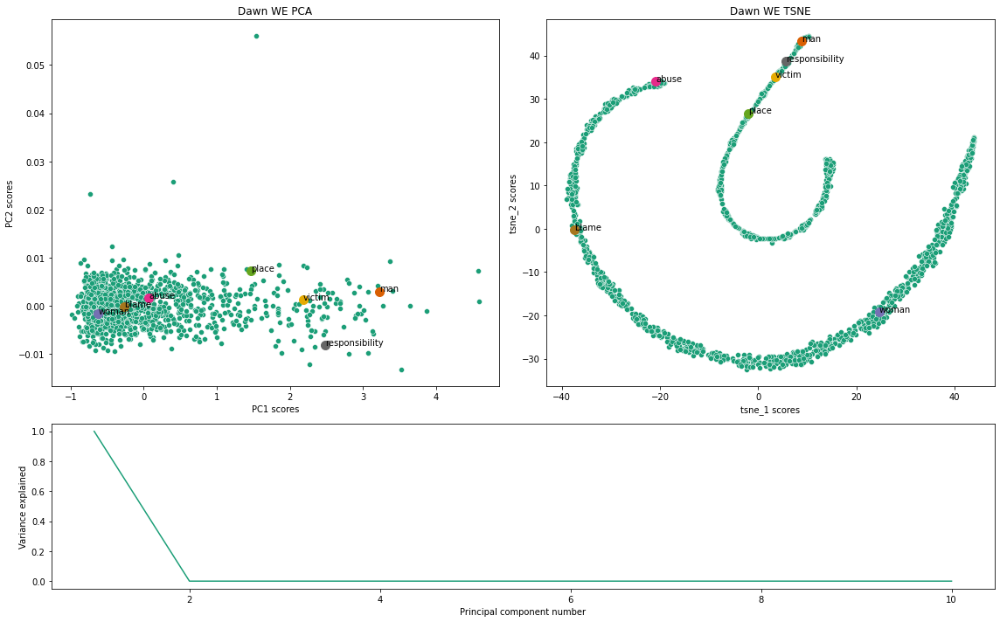

In [70]:
fig = visualize_embeddings(X_dawn, words_of_interest, "Dawn WE")

In [71]:
# Dimensionality of the Nation's word embedding too low to create plots
fig = visualize_embeddings(X_nation, words_of_interest, "The Nation WE")

ValueError: n_components=10 must be between 0 and min(n_samples, n_features)=1 with svd_solver='full'

# UK Newspaper Analysis

In [3]:
the_guardian = pd.read_csv("../data/UK/guardian_scraped_cleaned.csv")
the_times = pd.read_csv("../data/UK/times_scraped_cleaned.csv")
the_sun = pd.read_csv("../data/UK/sun_scraped_cleaned.csv")

In [9]:
the_guardian.loc[:,"webTitle"] = the_guardian["webTitle"].str.pad(1, side ='right', fillchar =' ')
the_guardian.loc[:,"complete_text"]  = the_guardian.webTitle.str.cat(the_guardian.body).astype(str)

the_times.loc[:,"title"] = the_times["title"].str.pad(1, side ='right', fillchar =' ')
the_times.loc[:,"complete_text"]  = the_times.title.str.cat(the_times.text).astype(str)

the_sun.loc[:,"title"] = the_sun["title"].str.pad(1, side ='right', fillchar =' ')
the_sun.loc[:,"complete_text"]  = the_sun.title.str.cat(the_sun.text).astype(str)

### Create word2vec objects for each newspaper

In [11]:
cbow_Embed = WEmbeddings(the_guardian, "complete_text")
theGuardian_w2v = cbow_Embed()
theGuardian_w2v.save("../data/UK/theGuardian_w2v.model")

In [12]:
cbow_Embed = WEmbeddings(the_times, "complete_text")
theTimes_w2v = cbow_Embed()
theTimes_w2v.save("../data/UK/theTimes_w2v.model")

In [13]:
cbow_Embed = WEmbeddings(the_sun, "complete_text")
theSun_w2v = cbow_Embed()
theSun_w2v.save("../data/UK/theSun_w2v.model")

In [25]:
# If already saved just load the embeddings since creating them is computationally expensive
theGuardian_w2v = gensim.models.Word2Vec.load("../data/UK/theGuardian_w2v.model")
theTimes_w2v = gensim.models.Word2Vec.load("../data/UK/theTimes_w2v.model")
theSun_w2v = gensim.models.Word2Vec.load("../data/UK/theSun_w2v.model")

w2v_dict = {"The Guardian": theGuardian_w2v, "The Times":theTimes_w2v, "The Sun": theSun_w2v}

In [74]:
words_of_interest = ["man", "woman", "abuse", "place", "victim", "blame", "responsibility"]
results = []

for word in words_of_interest:
    print(f"Finding words most similar to '{word}' according to its embedding")

    rep_words_jor, sentiment_jor = extract_info_word2vec(theGuardian_w2v, word, 'en')
    rep_words_uni, sentiment_uni = extract_info_word2vec(theTimes_w2v, word, 'en')
    rep_words_heral, sentiment_heral = extract_info_word2vec(theSun_w2v, word, 'en')


    d = { "keyword": word, 
          "closest_the_guardian": rep_words_jor,
          "sentiment_the_guardian": sentiment_jor,
          "closest_the_times": rep_words_uni,
          "sentiment_the_times": sentiment_uni,
          "closest_the_sun": rep_words_heral,
          "sentiment_the_sun": sentiment_heral
            }
    results.append(d)

Finding words most similar to 'man' according to its embedding
Finding words most similar to 'woman' according to its embedding
Finding words most similar to 'abuse' according to its embedding
Finding words most similar to 'place' according to its embedding
Finding words most similar to 'victim' according to its embedding
Finding words most similar to 'blame' according to its embedding
Finding words most similar to 'responsibility' according to its embedding


In [75]:
resulds_df_uk = pd.DataFrame(results)
resulds_df_uk

,keyword,closest_the_guardian,sentiment_the_guardian,closest_the_times,sentiment_the_times,closest_the_sun,sentiment_the_sun
0,man,"[teenager, girl, boy, rapist, male, attacker, ...",-0.9042,"[age, british, include, murder, mr, live, fami...",-0.6908,"[20s, attacker, female, unconscious, mile, tra...",-0.7783
1,woman,"[women.</p, female, male, girl, man, survivor,...",0.3612,"[accuse, man, include, age, case, convict, cou...",-0.6908,"[female, male, fear, girl, harass, mutilation,...",-0.9001
2,abuse,"[abuse.</p, abuse</a, assaults.</p, exploitati...",-0.8271,"[child, victim, offence, harassment, sexual, a...",-0.9403,"[hotline, intimacy, groom, harassment, miscond...",-0.7506
3,place,"[advantage, seriously, step, approach, place.<...",0.4939,"[work, company, house, right, state, family, w...",0.0000,"[seriously, advantage, reassurance, kilometre,...",0.4939
4,victim,"[perpetrator, survivor, abuser, instance, pros...",-0.8591,"[report, allege, charge, sex, numb, offence, i...",-0.8271,"[female, horrific, sexually, attacker, authori...",-0.7650
5,blame,"[ignore, mistreatment, motivate, failure, resp...",-0.9118,"[mr, president, feel, make, mark, age, world, ...",0.4404,"[intimidate, unreported, scale, trigger, wolf,...",-0.7579
6,responsibility,"[seriously, proper, practice, appropriate, ens...",0.5106,"[london, city, story, mean, serve, work, party...",0.4019,"[vital, specific, system, discussion, scale, o...",0.5423


In [101]:
resulds_df_uk.to_excel("UK_word2vec_summary.xlsx")

## Word Analogies and Semantic Algebra

In [28]:
for w2v in w2v_dict.keys():
    print("Newspaper: ", w2v)
    print(analogy_solving(w2v_dict[w2v], ["woman", "victim"], ["man"]))

    print()

Newspaper:  The Guardian
[('survivor', 0.713281512260437), ('perpetrator', 0.5293508768081665), ('counsel', 0.5124499201774597), ('charity', 0.4929940104484558), ('domestic', 0.4883573353290558), ('abuser', 0.4838698208332062), ('women.</p', 0.47242864966392517), ('stalker', 0.44382306933403015), ('legal', 0.4352268576622009), ('abuse', 0.43516308069229126)]

Newspaper:  The Times
[('charge', 0.9998225569725037), ('offence', 0.9998214244842529), ('allege', 0.9998164772987366), ('violence', 0.9998095631599426), ('report', 0.9998065233230591), ('child', 0.9998047947883606), ('sex', 0.999801754951477), ('harassment', 0.9997995495796204), ('numb', 0.9997938871383667), ('investigation', 0.9997851848602295)]

Newspaper:  The Sun
[('survivor', 0.7498793601989746), ('domestic', 0.7488607168197632), ('harassment', 0.7308387160301208), ('demand', 0.7125765085220337), ('mutilation', 0.7088014483451843), ('seek', 0.7051286697387695), ('hotline', 0.7039868831634521), ('harass', 0.6925029158592224),

### Visualizing Word Embeddings using dimensionality reduction

In [7]:
# Retrieve vectors
X_the_guardian = theGuardian_w2v[theGuardian_w2v.wv.vocab]
X_times = theTimes_w2v[theTimes_w2v.wv.vocab]
X_sun = theSun_w2v[theSun_w2v.wv.vocab]

<ipython-input-7-9dc77a529e65>:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_the_guardian = theGuardian_w2v[theGuardian_w2v.wv.vocab]
<ipython-input-7-9dc77a529e65>:3: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_times = theTimes_w2v[theTimes_w2v.wv.vocab]
<ipython-input-7-9dc77a529e65>:4: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  X_sun = theSun_w2v[theSun_w2v.wv.vocab]


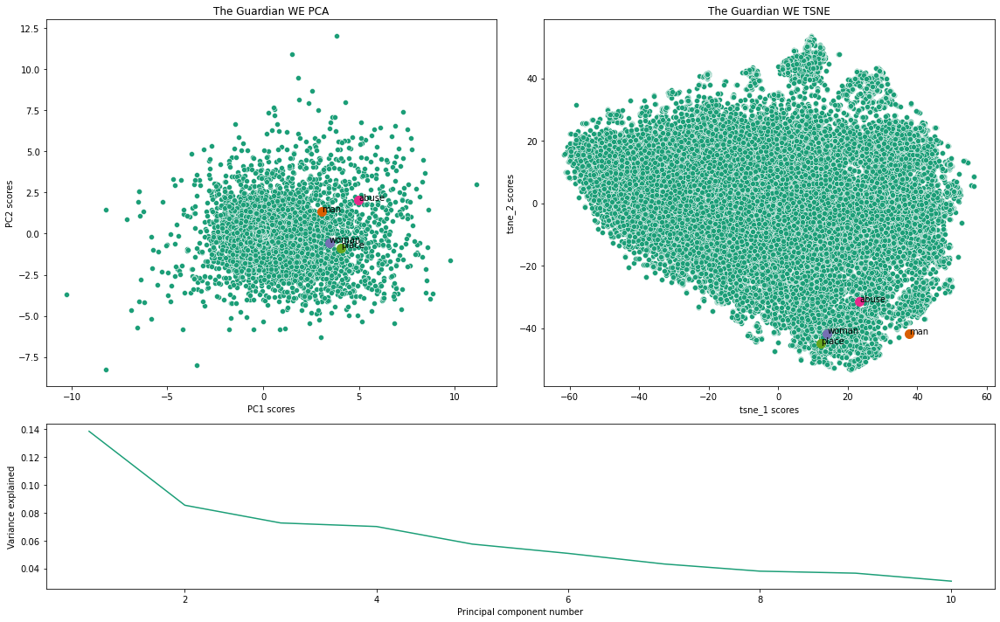

In [8]:
fig = visualize_embeddings(X_the_guardian, words_of_interest, "The Guardian WE")

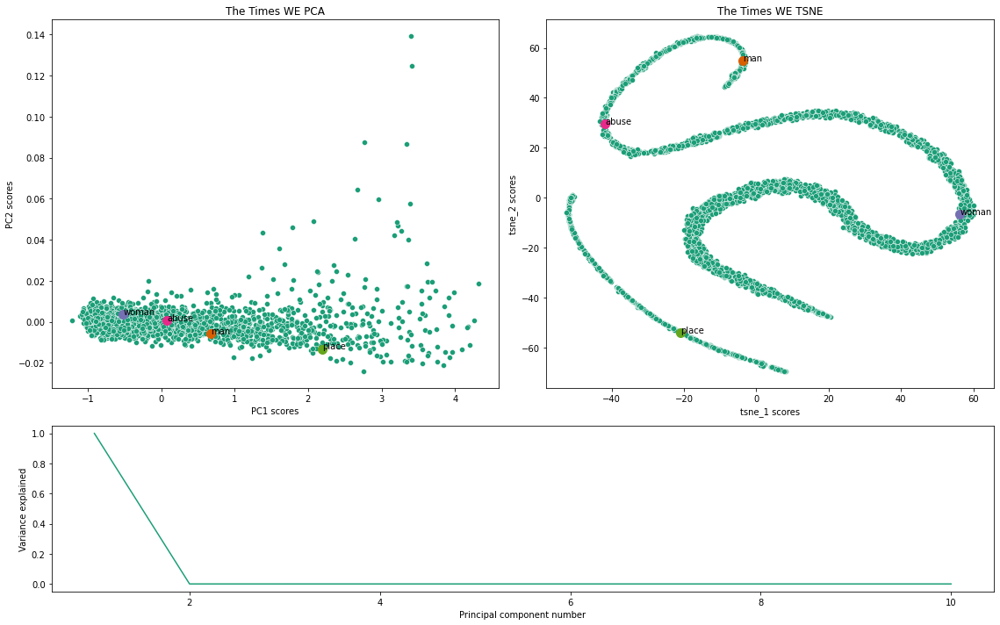

In [9]:
fig = visualize_embeddings(X_times, words_of_interest, "The Times WE")

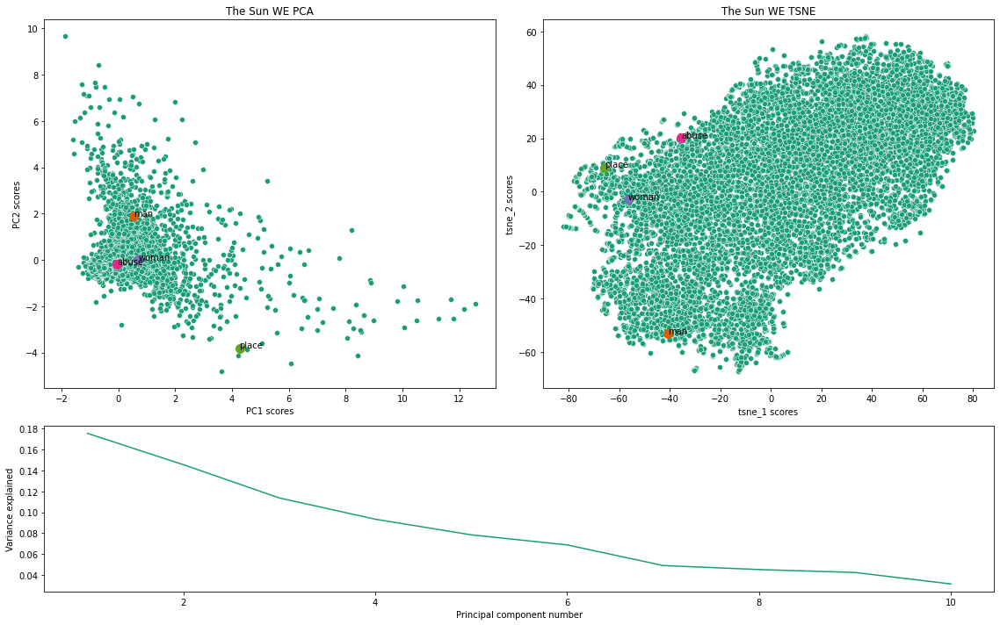

In [10]:
fig = visualize_embeddings(X_sun, words_of_interest, "The Sun WE")

# Glove word2vec semantic ralationships

In [ ]:
# Load glove pre-trained embeddings 
glove_w2v = api.load("glove-wiki-gigaword-100")

In [91]:
words_of_interest = ["man", "woman", "abuse", "place", "victim", "blame", "responsibility"]
results = []

for word in words_of_interest:
    print(f"Finding words most similar to '{word}' according to its embedding")

    rep_words_jor, sentiment_jor = extract_info_word2vec(glove_w2v, word, 'en')


    d = { "keyword": word, 
          "closest_glove": rep_words_jor,
          "sentiment_glove": sentiment_jor,
            }
    results.append(d)

Finding words most similar to 'man' according to its embedding
Finding words most similar to 'woman' according to its embedding
Finding words most similar to 'abuse' according to its embedding
Finding words most similar to 'place' according to its embedding
Finding words most similar to 'victim' according to its embedding
Finding words most similar to 'blame' according to its embedding
Finding words most similar to 'responsibility' according to its embedding


In [92]:
results_df_glove = pd.DataFrame(results)
results_df_glove

,keyword,closest_glove,sentiment_glove
0,man,"[woman, boy, one, person, another, old, life, ...",0.0000
1,woman,"[girl, man, mother, boy, she, child, wife, her...",0.0000
2,abuse,"[sexual, sex, abuses, allegations, rape, haras...",-0.9493
3,place,"[time, only, one, take, next, this, the, place...",0.0000
4,victim,"[victims, woman, child, man, murder, death, wi...",-0.9201
5,blame,"[blaming, blamed, ignore, ignoring, wrong, res...",-0.9678
6,responsibility,"[responsible, responsibilities, leadership, bl...",0.5574


In [102]:
results_df_glove.to_excel("Glove_word2vec_summary.xlsx")